# Segmentation of Indian Traffic

In [1]:
!pip install tensorflow==2.2.0

     |████████████████████████████████| 516.2MB 34kB/s 
     |████████████████████████████████| 460kB 40.4MB/s 
     |████████████████████████████████| 3.0MB 41.4MB/s 
     |████████████████████████████████| 2.9MB 29.4MB/s 
  Found existing installation: tensorflow-estimator 2.5.0
    Uninstalling tensorflow-estimator-2.5.0:
      Successfully uninstalled tensorflow-estimator-2.5.0
  Found existing installation: tensorboard 2.5.0
    Uninstalling tensorboard-2.5.0:
      Successfully uninstalled tensorboard-2.5.0
  Found existing installation: gast 0.4.0
    Uninstalling gast-0.4.0:
      Successfully uninstalled gast-0.4.0
  Found existing installation: h5py 3.1.0
    Uninstalling h5py-3.1.0:
      Successfully uninstalled h5py-3.1.0
  Found existing installation: tensorflow 2.5.0
    Uninstalling tensorflow-2.5.0:
      Successfully uninstalled tensorflow-2.5.0


In [2]:
!pip install keras==2.3.1

     |████████████████████████████████| 378kB 8.1MB/s 
     |████████████████████████████████| 51kB 6.6MB/s 
  Found existing installation: Keras 2.4.3
    Uninstalling Keras-2.4.3:
      Successfully uninstalled Keras-2.4.3


In [3]:
!pip install -U segmentation-models

In [4]:
!wget --header="Host: doc-10-1c-docs.googleusercontent.com" --header="User-Agent: Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/90.0.4430.212 Safari/537.36" --header="Accept: text/html,application/xhtml+xml,application/xml;q=0.9,image/avif,image/webp,image/apng,*/*;q=0.8,application/signed-exchange;v=b3;q=0.9" --header="Accept-Language: en-US,en;q=0.9" --header="Cookie: AUTH_j7lgv24r2n2ldusbdcprc336tqksmi3e_nonce=216u5g9b6n3pu" --header="Connection: keep-alive" "https://doc-10-1c-docs.googleusercontent.com/docs/securesc/k1670ni53mgveu8rd2js7r6odg5ro9el/fk05afntkamd252jd4r8ha6d9ngtob9n/1622011125000/00484516897554883881/06809510369874260004/1iQ93IWVdR6dZ6W7RahbLq166u-6ADelJ?e=download&authuser=0&nonce=216u5g9b6n3pu&user=06809510369874260004&hash=1tai90bq63oeh25bm7cta0sirvncfsk1" -c -O 'data.zip'

--2021-05-26 06:41:25--  https://doc-10-1c-docs.googleusercontent.com/docs/securesc/k1670ni53mgveu8rd2js7r6odg5ro9el/fk05afntkamd252jd4r8ha6d9ngtob9n/1622011125000/00484516897554883881/06809510369874260004/1iQ93IWVdR6dZ6W7RahbLq166u-6ADelJ?e=download&authuser=0&nonce=216u5g9b6n3pu&user=06809510369874260004&hash=1tai90bq63oeh25bm7cta0sirvncfsk1
Resolving doc-10-1c-docs.googleusercontent.com (doc-10-1c-docs.googleusercontent.com)... 142.250.101.132, 2607:f8b0:4023:c06::84
Connecting to doc-10-1c-docs.googleusercontent.com (doc-10-1c-docs.googleusercontent.com)|142.250.101.132|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [application/x-zip-compressed]
Saving to: ‘data.zip’

data.zip                [    <=>             ]   2.18G  34.5MB/s    in 28s     

2021-05-26 06:41:53 (80.9 MB/s) - ‘data.zip’ saved [2339740971]



In [5]:
!unzip data.zip

Streaming output truncated to the last 5000 lines.
  inflating: data/images/377/frame28480_leftImg8bit.jpg  
  inflating: data/images/377/frame28699_leftImg8bit.jpg  
  inflating: data/images/377/frame28808_leftImg8bit.jpg  
  inflating: data/images/377/frame29080_leftImg8bit.jpg  
  inflating: data/images/377/frame29271_leftImg8bit.jpg  
  inflating: data/images/377/frame29435_leftImg8bit.jpg  
  inflating: data/images/377/frame29653_leftImg8bit.jpg  
  inflating: data/images/377/frame29817_leftImg8bit.jpg  
  inflating: data/images/377/frame30062_leftImg8bit.jpg  
  inflating: data/images/377/frame30199_leftImg8bit.jpg  
  inflating: data/images/377/frame3039_leftImg8bit.jpg  
  inflating: data/images/377/frame30417_leftImg8bit.jpg  
  inflating: data/images/377/frame30499_leftImg8bit.jpg  
  inflating: data/images/377/frame30608_leftImg8bit.jpg  
  inflating: data/images/377/frame30744_leftImg8bit.jpg  
  inflating: data/images/377/frame30908_leftImg8bit.jpg  
  inflating: data/imag

In [6]:
import math
from PIL import Image, ImageDraw
from PIL import ImagePath
import pandas as pd
import os
from os import path
from tqdm import tqdm
import json
import cv2
import numpy as np
import matplotlib.pyplot as plt
import urllib
import urllib.request 
%matplotlib inline

In [7]:
import tensorflow as tf
from tensorflow import keras
import imgaug.augmenters as iaa
os.environ['TF_FORCE_GPU_ALLOW_GROWTH'] = 'true'
from tensorflow.keras import layers
from tensorflow.keras.layers import Dense,Input,Conv2D,MaxPool2D,Activation,Dropout,Flatten, LSTM, BatchNormalization, ReLU, Reshape,Add,UpSampling2D,MaxPooling2D,GlobalAveragePooling2D,concatenate,Multiply
from tensorflow.keras.models import Model
import random as rn
from sklearn.model_selection import train_test_split
os.environ["SM_FRAMEWORK"]="tf.keras"
import segmentation_models as sm
from segmentation_models import Unet
from segmentation_models.metrics import iou_score
tf.keras.backend.set_image_data_format('channels_last')
#tf.compat.v1.enable_eager_execution()
from tensorflow.keras.layers import *
from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras import backend as K
from tensorflow.keras.layers import   ZeroPadding2D, AveragePooling2D, GlobalMaxPooling2D
from tensorflow.keras.utils import plot_model
from tensorflow.keras.initializers import glorot_uniform,glorot_normal
K.set_image_data_format('channels_last')
K.set_learning_phase(1)
tf.config.experimental_run_functions_eagerly(True)
import datetime
%load_ext tensorboard

Segmentation Models: using `tf.keras` framework.


In [8]:
tf.executing_eagerly()

True

<pre>
1. You can download the data from this link, and extract it

2. All your data will be in the folder "data" 

3. Inside the data you will be having two folders

|--- data
|-----| ---- images
|-----| ------|----- Scene 1
|-----| ------|--------| ----- Frame 1 (image 1)
|-----| ------|--------| ----- Frame 2 (image 2)
|-----| ------|--------| ----- ...
|-----| ------|----- Scene 2
|-----| ------|--------| ----- Frame 1 (image 1)
|-----| ------|--------| ----- Frame 2 (image 2)
|-----| ------|--------| ----- ...
|-----| ------|----- .....
|-----| ---- masks
|-----| ------|----- Scene 1
|-----| ------|--------| ----- json 1 (labeled objects in image 1)
|-----| ------|--------| ----- json 2 (labeled objects in image 1)
|-----| ------|--------| ----- ...
|-----| ------|----- Scene 2
|-----| ------|--------| ----- json 1 (labeled objects in image 1)
|-----| ------|--------| ----- json 2 (labeled objects in image 1)
|-----| ------|--------| ----- ...
|-----| ------|----- .....
</pre>

# Task 1: Preprocessing

## 1. Get all the file name and corresponding json files

In [9]:
def return_file_names_df(root_dir):
    # write the code that will create a dataframe with two columns ['images', 'json']
    # the column 'image' will have path to images
    # the column 'json' will have path to json files
    data_df = pd.DataFrame(columns=['image','json'])
    temp=[]
    for root, dirs, files in os.walk(os.path.join(root_dir, "images")):
        dirs.sort()
        for name in sorted(files):
            temp.append(os.path.join(root, name))
    data_df["image"] = temp
    temp = []
    for root, dirs, files in os.walk(os.path.join(root_dir, "mask")):
        dirs.sort()
        for name in sorted(files):
            temp.append(os.path.join(root, name))
    data_df["json"] = temp
    return data_df

In [10]:
data_df = return_file_names_df("data")
data_df.head()

,image,json
0,data/images/201/frame0029_leftImg8bit.jpg,data/mask/201/frame0029_gtFine_polygons.json
1,data/images/201/frame0299_leftImg8bit.jpg,data/mask/201/frame0299_gtFine_polygons.json
2,data/images/201/frame0779_leftImg8bit.jpg,data/mask/201/frame0779_gtFine_polygons.json
3,data/images/201/frame1019_leftImg8bit.jpg,data/mask/201/frame1019_gtFine_polygons.json
4,data/images/201/frame1469_leftImg8bit.jpg,data/mask/201/frame1469_gtFine_polygons.json


> In the dataframe, we can consider each row as single data point, where first feature is image and the second feature is corresponding json file

In [13]:
data_df.shape

(4008, 2)

## 2. Structure of sample Json file

<img src='https://i.imgur.com/EfR5KmI.png' width="200" height="100">

* Each File will have 3 attributes
    * imgHeight: which tells the height of the image
    * imgWidth: which tells the width of the image
    * objects: it is a list of objects, each object will have multiple attributes,
        * label: the type of the object
        * polygon: a list of two element lists, representing the coordinates of the polygon

#### Compute the unique labels

Let's see how many unique objects are there in the json file.
to see how to get the object from the json file <a href='https://www.geeksforgeeks.org/read-json-file-using-python/'>this blog </a>

In [14]:
def return_unique_labels(data_df):
    # for each file in the column json
    #       read and store all the objects present in that file
    # compute the unique objects and retrun them
    unique_labels = []
    for json_path in data_df.json:
        with open(json_path) as f:
            data = json.load(f)
            unique_labels.extend([dict_obj['label'] for dict_obj in data['objects'] ])
            unique_labels = list(set(unique_labels))
    # if open any json file using any editor you will get better sense of it
    return unique_labels

In [15]:
unique_labels = return_unique_labels(data_df)

<img src='https://i.imgur.com/L4QH6Tp.png'>

In [16]:
label_clr = {'road':10, 'parking':20, 'drivable fallback':20,'sidewalk':30,'non-drivable fallback':40,'rail track':40,\
                        'person':50, 'animal':50, 'rider':60, 'motorcycle':70, 'bicycle':70, 'autorickshaw':80,\
                        'car':80, 'truck':90, 'bus':90, 'vehicle fallback':90, 'trailer':90, 'caravan':90,\
                        'curb':100, 'wall':100, 'fence':110,'guard rail':110, 'billboard':120,'traffic sign':120,\
                        'traffic light':120, 'pole':130, 'polegroup':130, 'obs-str-bar-fallback':130,'building':140,\
                        'bridge':140,'tunnel':140, 'vegetation':150, 'sky':160, 'fallback background':160,'unlabeled':0,\
                        'out of roi':0, 'ego vehicle':170, 'ground':180,'rectification border':190,\
                   'train':200}

<pre>
* here we have given a number for each of object types,  we are having 21 different set of objects
* we have multiplies each object's number with 10, that is just to make different objects look differently in the segmentation map
* Before passing it to the models, we need to devide the image array /10.
</pre>

## 3. Extracting the polygons from the json files

In [18]:
def get_poly(file):
    # this function will take a file name as argument
    
    # it will process all the objects in that file and returns
    
    # label: a list of labels for all the objects label[i] will have the corresponding vertices in vertexlist[i]
    # len(label) == number of objects in the image
    with open(file) as f:
        data = json.load(f)
        w = data['imgWidth']
        h = data['imgHeight']
        label = []
        vertexlist=[]
        for dict_obj in data['objects']:
            if len(dict_obj['polygon'])>1:
                label.append(dict_obj['label'])
                vertexlist.append(list(map(tuple,dict_obj['polygon'])))
        # to remove all the empty elements from vertexlist
    # vertexlist: it should be list of list of vertices in tuple formate 
    # ex: [[(x11,y11), (x12,y12), (x13,y13) .. (x1n,y1n)]
    #     [(x21,y21), (x22,y12), (x23,y23) .. (x2n,y2n)]
    #      .....
    #     [(xm1,ym1), (xm2,ym2), (xm3,ym3) .. (xmn,ymn)]]
    # len(vertexlist) == number of objects in the image
    
    # * note that label[i] and vertextlist[i] are corresponds to the same object, one represents the type of the object
    # the other represents the location
    
    # width of the image
    # height of the image
    return w, h, label, vertexlist

## 4. Creating Image segmentations by drawing set of polygons

### Example

(28, 28, 3)
[[0 0 0 0 0 0 0 0 2 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 2 2 2 2 2 2 2 2 2 2 2 2 2 2 0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 0 0 0 0 0 0 0 0 0 0 0]
 [0 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 0 0 0 0 0 0 0 0 0 0 0]
 [0 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 0 0 0 0 0 0 0 0 0 0]
 [2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 0 0 0 0 0 0 0 0 0 0]
 [2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 0 0 0 0 0 0 0 0 0]
 [0 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 0 0 0 0 0 0 0 0 0 0]
 [0 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 2 2 2 2 2 2 2 2 2 2 2 2 2 2 0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 2 2 2 2 2 2 2 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 2 0 0 0 0 0 0 0 3 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 3 3 3 3 3 3 3 3 3 3 3 3 3 3 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 0 0]
 [0 0 0 0 0 0 0 0 0 0 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 0 0]
 [0 0 0 0 0 0 0 0 0 0 3 3 3 3 3 3 3 3 3 3 3 

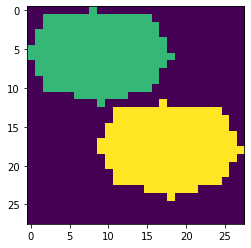

In [20]:
 side=8
x1 = [ ((math.cos(th) + 1) *9, (math.sin(th) + 1) * 6) for th in [i * (2 * math.pi) / side for i in range(side)] ]
x2 = [ ((math.cos(th) + 2) *9, (math.sin(th) + 3) *6) for th in [i * (2 * math.pi) / side for i in range(side)] ]

img = Image.new("RGB", (28,28))
img1 = ImageDraw.Draw(img)
# please play with the fill value
# writing the first polygon
img1.polygon(x1, fill =20)
# writing the second polygon
img1.polygon(x2, fill =30)

img=np.array(img)
# note that the filling of the values happens at the channel 1, so we are considering only the first channel here
plt.imshow(img[:,:,0])
print(img.shape)
print(img[:,:,0]//10)
im = Image.fromarray(img[:,:,0])
im.save("test_image.png")

In [21]:
for dir_ in os.listdir('data/images'):
    if not os.path.isdir(path.join("data/output/",dir_)):
        os.makedirs(path.join("data/output/",dir_))

In [22]:
def compute_masks(data_df):
    # after you have computed the vertexlist plot that polygone in image like this
    mask_path=[]
    for json_path in tqdm(data_df.json) :
        w,h,label, vertexlist = get_poly(json_path)
        img = Image.new("RGB", (w, h))
        img1 = ImageDraw.Draw(img)        
        for i in range(len(label)):
            img1.polygon(vertexlist[i], fill = label_clr[label[i]])
        img=np.array(img)
        Image.fromarray(img[:,:,0]).save(os.path.join("data/output/",json_path.split('.')[0][10:]+".png"),format='PNG')
    # after drawing all the polygons that we collected from json file, 
    # you need to store that image in the folder like this "data/output/scene/framenumber_gtFine_polygons.png"
        mask_path.append( os.path.join("data/output/",json_path.split('.')[0][10:]+".png"))
    # after saving the image into disk, store the path in a list
    # after storing all the paths, add a column to the data_df['mask'] ex: data_df['mask']= mask_paths
    data_df['mask'] = mask_path
    return data_df

In [23]:
data_df = compute_masks(data_df)
data_df.head()

100%|██████████| 4008/4008 [03:52<00:00, 17.23it/s]


,image,json,mask
0,data/images/201/frame0029_leftImg8bit.jpg,data/mask/201/frame0029_gtFine_polygons.json,data/output/201/frame0029_gtFine_polygons.png
1,data/images/201/frame0299_leftImg8bit.jpg,data/mask/201/frame0299_gtFine_polygons.json,data/output/201/frame0299_gtFine_polygons.png
2,data/images/201/frame0779_leftImg8bit.jpg,data/mask/201/frame0779_gtFine_polygons.json,data/output/201/frame0779_gtFine_polygons.png
3,data/images/201/frame1019_leftImg8bit.jpg,data/mask/201/frame1019_gtFine_polygons.json,data/output/201/frame1019_gtFine_polygons.png
4,data/images/201/frame1469_leftImg8bit.jpg,data/mask/201/frame1469_gtFine_polygons.json,data/output/201/frame1469_gtFine_polygons.png


# Task 2: Applying Unet to segment the images

<pre>
* please check the paper: https://arxiv.org/abs/1505.04597

* <img src='https://i.imgur.com/rD4yP7J.jpg' width="500">



</pre>

### Task 2.1: Dice loss

<h4>Dice Loss :</h4>

* Dice Loss is a metric used to measure similarity between two samples. It was introduced into computer vision for the purpose of 3D medical image segmentation. In the context of Image segmentation, it is used to compare the predicted segmented image against ground truth segmented image. 


<h4>Formulation :</h4>

 <img src='https://imgur.com/sOjoLk4.png' width=200>

In the above formulation of dice loss, $p_i$ and $g_i$ represent pixel values of predicted image and ground truth image respectively. 

Numerator is the sum of correctly predicted pixels and denominator is sum of total pixels of predicted and ground truth. Hence dice loss considers loss information both locally as well as globally.
* If $p_i$ = $g_i$ for all i , then dice loss = 1 . This happens when predicted images exactly equals ground truth image.(ideal case)
* In practical, $g_i$ is either 0 or 1 (1 in the region where object is present and 0 elsewhere) and $p_i$ lies between 0 and 1 (as we use sigmoid/softmax activation in the last output layer). Hence the range of dice loss is between 0 and 1.


### Task 2.2: Training Unet


<pre>
* Split the data into 80:20.
* Train the UNET on the given dataset and plot the train and validation loss.
* As shown in the reference notebook plot 20 images from the test data along with its segmentation map, predicted map.
</pre>

In [25]:
X_train, X_test = train_test_split(data_df, test_size=0.2, random_state=42)
IMAGE_HEIGHT = 512
IMAGE_WIDTH = 512

In [26]:
# For the assignment choose any 4 augumentation techniques
# check the imgaug documentations for more augmentations
aug2 = iaa.Fliplr(1)
#aug3 = iaa.Flipud(1)
aug3 = iaa.Emboss(alpha=(0.5), strength=1)
aug4 = iaa.DirectedEdgeDetect(alpha=(0.5), direction=(1.0))
aug5 = iaa.Sharpen(alpha=(0.5), lightness=(1.5))

In [27]:
def visualize(**images):
    n = len(images)
    plt.figure(figsize=(16, 5))
    for i, (name, image) in enumerate(images.items()):
        plt.subplot(1, n, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(' '.join(name.split('_')).title())
        plt.imshow(image)
    plt.show()
    
def normalize_image(mask):
    mask = mask/255
    return mask

class Dataset:
    # we will be modifying this CLASSES according to your data/problems
    CLASSES = ['out of roi','road','parking','sidewalk','non-drivable fallback','person','rider','motorcycle','autorickshaw','truck','curb','fence','billboard','pole','building','vegetation','sky','ego vehicle','ground','rectification border','train']
    
    # the parameters needs to changed based on your requirements
    # here we are collecting the file_names because in our dataset, both our images and maks will have same file name
    # ex: fil_name.jpg   file_name.mask.jpg
    def __init__(self, data_df ,classes,augmentation):
        
        self.len = data_df.shape[0]
        # the paths of images
        self.images_fps   = data_df['image'].values
        # the paths of segmentation images
        self.masks_fps    = data_df['mask'].values
        # giving labels for each class
        self.class_values = [self.CLASSES.index(cls.lower()) for cls in classes]
        self.augmentation = augmentation
    def __getitem__(self, i):
        
        # read data
        #image
        image = cv2.imread(self.images_fps[i], cv2.IMREAD_UNCHANGED)
        image = cv2.resize(image,(IMAGE_WIDTH,IMAGE_HEIGHT),interpolation=cv2.INTER_NEAREST)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        #mask
        mask  = cv2.imread(self.masks_fps[i], 0)
        mask = cv2.resize(mask,(IMAGE_WIDTH,IMAGE_HEIGHT),interpolation=cv2.INTER_NEAREST)
        image_mask = mask

        
        image_masks = [(image_mask == 10*v) for v in self.class_values]
        image_mask = np.stack(image_masks, axis=-1).astype('float')
        if self.augmentation:
            a = np.random.uniform()
            if a<0.25:
                image = aug2.augment_image(image)
                image_mask = aug2.augment_image(image_mask)
            elif a<0.5:
                image = aug3.augment_image(image)
                image_mask = aug3.augment_image(image_mask)
            elif a<0.75:
                image = aug4.augment_image(image)
                image_mask = aug4.augment_image(image_mask)
            else:
                image = aug5.augment_image(image)
                image_mask = aug5.augment_image(image_mask)
           
        return image, image_mask
        
    def __len__(self):
        return self.len
    
    
class Dataloder(tf.keras.utils.Sequence):    
    def __init__(self, dataset, batch_size=1, shuffle=False):
        self.dataset = dataset
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.indexes = np.arange(len(dataset))
        self.on_epoch_end()

    def __getitem__(self, i):
        
        # collect batch data
        start = i * self.batch_size
        stop = (i + 1) * self.batch_size
        data = []
        for j in range(start, stop):
            data.append(self.dataset[j])
        
        batch = [np.stack(samples, axis=0) for samples in zip(*data)]
        
        return tuple(batch)
    
    def __len__(self):
        return len(self.indexes) // self.batch_size
    
    def on_epoch_end(self):
        if self.shuffle:
            self.indexes = np.random.permutation(self.indexes)

In [28]:
!rm -rf model_1_logs/fit/

In [29]:
# Dataset for train images
CLASSES = ['out of roi','road','parking','sidewalk','non-drivable fallback','person','rider','motorcycle','autorickshaw','truck','curb','fence','billboard','pole','building','vegetation','sky','ego vehicle','ground','rectification border','train']
train_dataset = Dataset(X_train,classes=CLASSES,augmentation=True)
test_dataset  = Dataset(X_test,classes=CLASSES,augmentation=False)

BATCH_SIZE=1
train_dataloader = Dataloder(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
test_dataloader = Dataloder(test_dataset, batch_size=1, shuffle=False)
print(train_dataloader[0][1].shape)
assert train_dataloader[0][0].shape == (BATCH_SIZE, IMAGE_WIDTH, IMAGE_HEIGHT, 3)
assert train_dataloader[0][1].shape == (BATCH_SIZE, IMAGE_WIDTH, IMAGE_HEIGHT, 21)

logdir = "model_1_logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
# define callbacks for learning rate scheduling and best checkpoints saving
callbacks = [
    tf.keras.callbacks.ModelCheckpoint("best_model_1.h5", monitor='val_iou_score',save_best_only=True, save_weights_only=True, mode='max'),
    tf.keras.callbacks.TensorBoard(log_dir=logdir,histogram_freq=1, write_graph=True,write_grads=True)
]


(1, 512, 512, 21)


In [30]:
# loading the unet model and using the resnet 34 and initilized weights with imagenet weights
# "classes" :different types of classes in the dataset
os.environ['PYTHONHASHSEED'] = '0'
tf.keras.backend.clear_session()
np.random.seed(0)
rn.seed(0)
model = Unet('resnet34', encoder_weights='imagenet',encoder_freeze=True, classes=21, activation='softmax', input_shape=(IMAGE_HEIGHT,IMAGE_WIDTH,3))

85524480/85521592 [==============================] - 3s 0us/step


In [31]:
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
data (InputLayer)               [(None, 512, 512, 3) 0                                            
__________________________________________________________________________________________________
bn_data (BatchNormalization)    (None, 512, 512, 3)  9           data[0][0]                       
__________________________________________________________________________________________________
zero_padding2d (ZeroPadding2D)  (None, 518, 518, 3)  0           bn_data[0][0]                    
__________________________________________________________________________________________________
conv0 (Conv2D)                  (None, 256, 256, 64) 9408        zero_padding2d[0][0]             
____________________________________________________________________________________________

In [32]:
# https://github.com/qubvel/segmentation_models

optim = tf.keras.optimizers.Adam()

jaccard_loss = sm.losses.JaccardLoss()
dice_loss = sm.losses.DiceLoss()

categorical_focal_loss = sm.losses.CategoricalFocalLoss()

categorical_crossentropy = sm.losses.CategoricalCELoss()

cce_dice_loss = categorical_crossentropy + dice_loss
cce_jaccard_loss = categorical_crossentropy + jaccard_loss

categorical_focal_dice_loss = categorical_focal_loss + dice_loss
categorical_focal_jaccard_loss = categorical_focal_loss + jaccard_loss
model.compile(optim, cce_dice_loss, metrics=[sm.metrics.IOUScore(threshold=0.5)])#categorical_focal_jaccard_loss

In [33]:
history_1 = model.fit(train_dataloader, steps_per_epoch=len(train_dataloader), epochs=3,\
                              validation_data=test_dataloader,validation_steps=len(test_dataloader), callbacks=callbacks,)#

Epoch 1/3
3206/3206 [==============================] - 1104s 344ms/step - loss: 0.8114 - iou_score: 0.4858 - val_loss: 0.7502 - val_iou_score: 0.5454
Epoch 2/3
3206/3206 [==============================] - 1086s 339ms/step - loss: 0.5566 - iou_score: 0.5111 - val_loss: 0.5269 - val_iou_score: 0.5489
Epoch 3/3
3206/3206 [==============================] - 1081s 337ms/step - loss: 0.5178 - iou_score: 0.5066 - val_loss: 0.5220 - val_iou_score: 0.5357


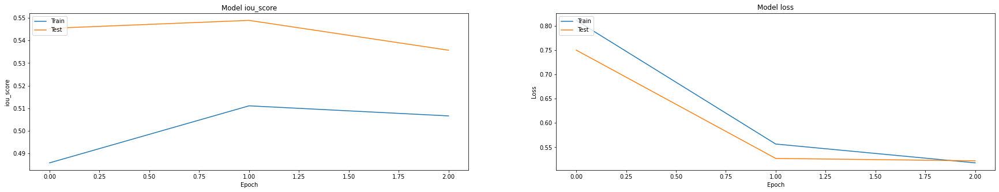

In [34]:
# Plot training & validation iou_score values
plt.figure(figsize=(30, 5))
plt.subplot(121)
plt.plot(history_1.history['iou_score'])
plt.plot(history_1.history['val_iou_score'])
plt.title('Model iou_score')
plt.ylabel('iou_score')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

# Plot training & validation loss values
plt.subplot(122)
plt.plot(history_1.history['loss'])
plt.plot(history_1.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()

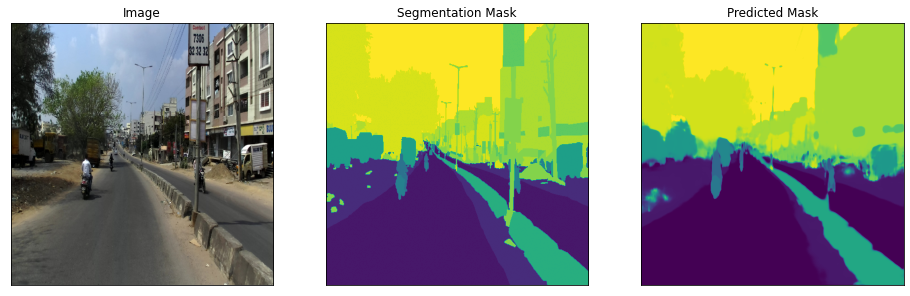

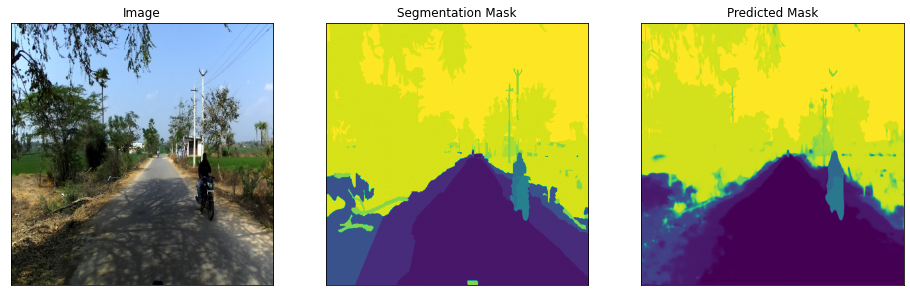

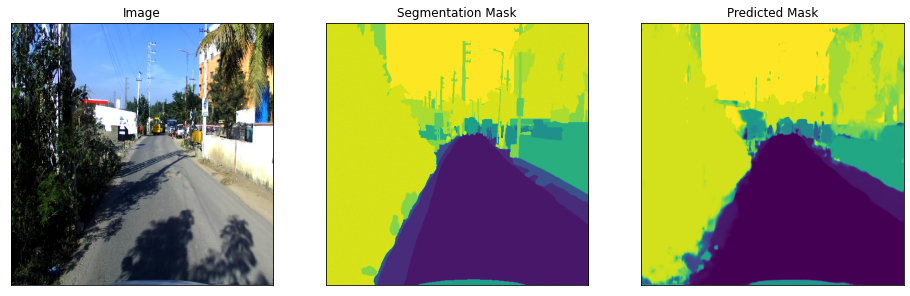

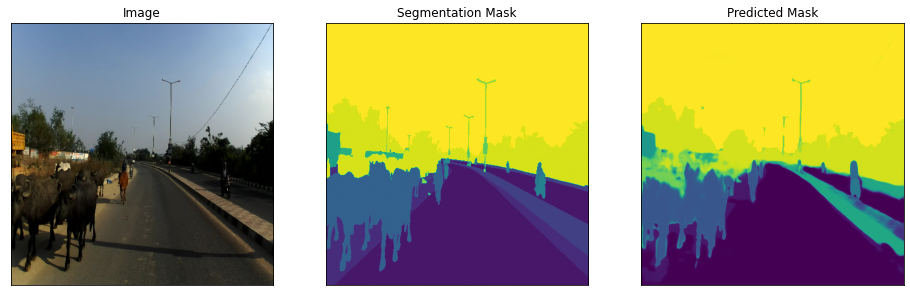

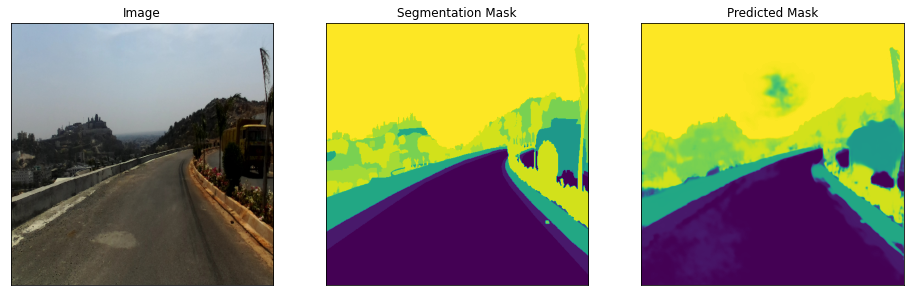

...

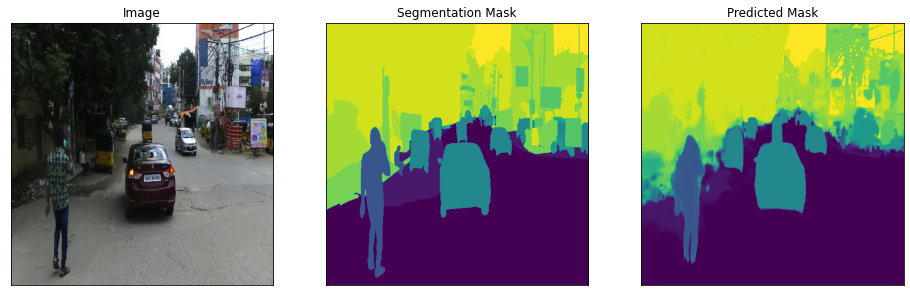

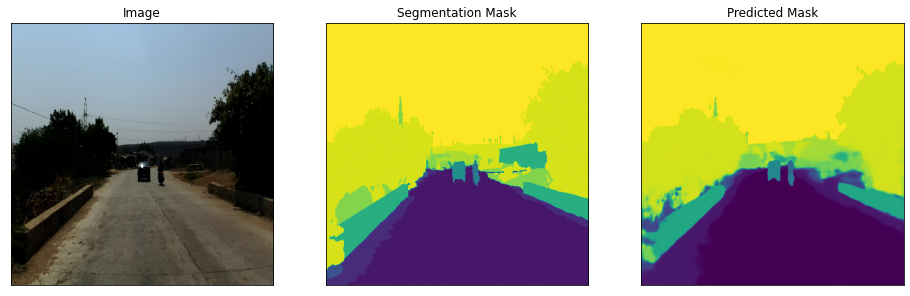

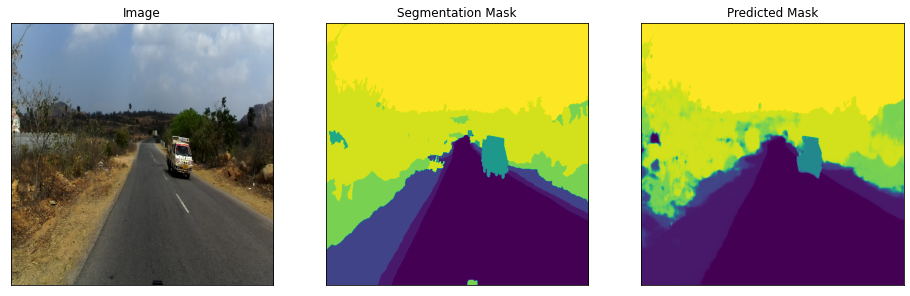

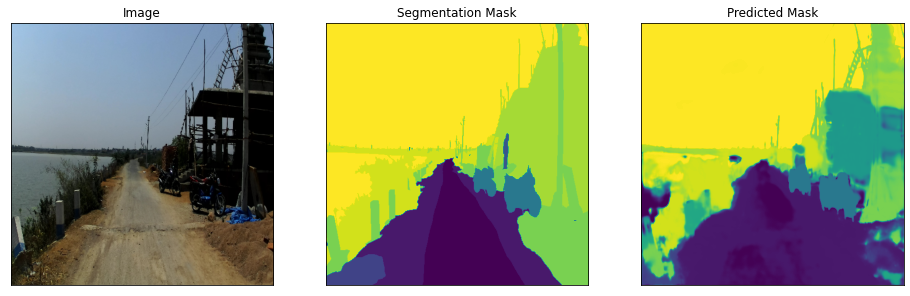

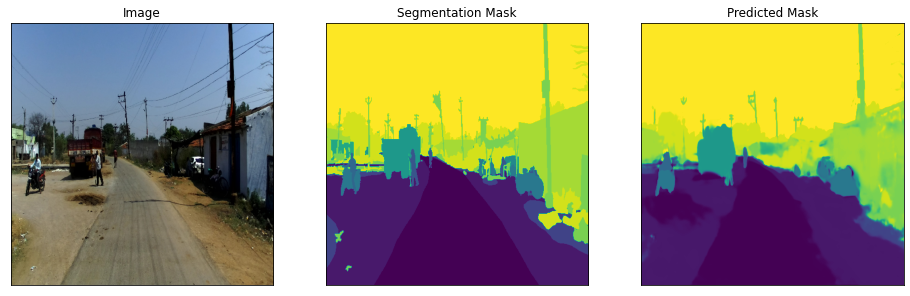

In [35]:
#visualizing 20 test images, their actual segmentation maps, predicted segmentation maps
for i in range(20):
    #print(test_dataloader[i][0].shape)
    segmentation_map = test_dataloader[i][1][0]
    segmentation_mask = np.sum(np.stack([segmentation_map[:,:,j]*j*10 for j in range(len(CLASSES))],axis=-1),axis=-1)
    predicted_mask = model.predict(test_dataloader[i][0])[0]
    predicted_mask = np.sum(np.stack([predicted_mask[:,:,j]*j*10 for j in range(len(CLASSES))],axis=-1),axis=-1)
    visualize(
    image=test_dataset[i][0], 
    segmentation_mask=segmentation_mask,
    predicted_mask=predicted_mask
    )

In [36]:
%tensorboard --logdir model_1_logs/fit

<IPython.core.display.Javascript object>

# Task 3: Training CANet

In [37]:
class convolutional_block(tf.keras.layers.Layer):
    def __init__(self, kernel,  filters, stride, name="conv block"):
        super().__init__(name=name)
        self.F1, self.F2, self.F3 = filters[0],filters[1],filters[2]
        self.kernel = kernel
        self.stride = stride
    def call(self, X_input):
        # write the architecutre that was mentioned above
        X = Conv2D(filters = self.F1, kernel_size=1,strides=1, padding="valid", kernel_initializer=glorot_uniform(seed=0))(X_input)
        X = BatchNormalization(axis=-1)(X)
        X = Activation('relu')(X)
        X = Conv2D(filters = self.F2, kernel_size = self.kernel,strides=self.stride, padding="same", kernel_initializer=glorot_uniform(seed=0))(X)
        X = BatchNormalization(axis=-1)(X)
        X = Activation('relu')(X)
        X = Conv2D(filters = self.F3, kernel_size = 1,strides=1, padding="valid", kernel_initializer=glorot_uniform(seed=0))(X)
        X = BatchNormalization(axis=-1)(X)
        X_input = Conv2D(filters = self.F3, kernel_size =self.kernel,strides=self.stride, padding="same", kernel_initializer=glorot_uniform(seed=0))(X_input)
        X_input = BatchNormalization(axis=-1)(X_input)
        X_input = Activation('relu')(X_input)
        X = Add()([X, X_input])
        X = Activation('relu')(X)
        return X

In [38]:
class identity_block(tf.keras.layers.Layer):
    def __init__(self, kernel,  filters, name="identity block"):
        super().__init__(name=name)
        self.F1, self.F2, self.F3 = filters[0],filters[1],filters[2]
        self.kernel = kernel
    def call(self, X_input):
        # write the architecutre that was mentioned above
        X = Conv2D(filters = self.F1, kernel_size = 1,strides=1, padding="valid", kernel_initializer=glorot_uniform(seed=0))(X_input)
        X = BatchNormalization(axis=-1)(X)
        X = Activation('relu')(X)
        X = Conv2D(filters = self.F2, kernel_size = self.kernel,strides=1, padding="same", kernel_initializer=glorot_uniform(seed=0))(X)
        X = BatchNormalization(axis=-1)(X)
        X = Activation('relu')(X)
        X = Conv2D(filters = self.F3,kernel_size = 1,strides=1, padding="valid", kernel_initializer=glorot_uniform(seed=0))(X)
        X = BatchNormalization(axis=-1)(X)
        X = Add()([X, X_input])
        X = Activation('relu')(X)
        return X

In [39]:
class global_flow(tf.keras.layers.Layer):
    def __init__(self, name="global_flow"):
        super().__init__(name=name)
        
    def call(self, X_input):
        # implement the global flow operatiom
        X = GlobalAveragePooling2D()(X_input)
        X = Reshape((1,1,X.shape[-1]))(X)
        X = BatchNormalization(axis=-1)(X)
        X = Activation('relu')(X)       
        X = Conv2D(filters = 64, kernel_size = 1,strides=1, padding="same",activation = 'relu', kernel_initializer=glorot_uniform(seed=0))(X)
        X = UpSampling2D(size = (X_input.shape[1],X_input.shape[2]),interpolation='bilinear')(X)
        return X

In [40]:
class context_flow(tf.keras.layers.Layer):    
    def __init__(self, name="context_flow"):
        super().__init__(name=name)
    def call(self, X):
        # here X will a list of two elements 
        INP, FLOW = X[0], X[1] 
        # implement the context flow as mentioned in the above cell
        X = concatenate([INP, FLOW],axis=-1)
        X = AveragePooling2D(pool_size=(2, 2), strides=(2,2))(X)
        X = Conv2D(filters=64, kernel_size = 3,strides=1,activation = 'relu', padding="same", kernel_initializer=glorot_uniform(seed=0))(X)
        X = Conv2D(filters = 64, kernel_size = 3,strides=1,activation = 'relu', padding="same", kernel_initializer=glorot_uniform(seed=0))(X)
        X_next = Conv2D(filters = 64,kernel_size = 1,strides=1,activation = 'relu', padding="same", kernel_initializer=glorot_uniform(seed=0))(X)
        X_next = Activation('relu')(X_next)
        X_next = Conv2D(filters = 64,kernel_size = 1,strides=1,activation = 'relu', padding="same", kernel_initializer=glorot_normal(seed=0))(X_next)
        X_next = Activation('sigmoid')(X_next)#sigmoid here
        X = Add()([Multiply()([X_next,X]),X])
        X = UpSampling2D(size = (2,2),interpolation='bilinear')(X)
        return X

In [41]:
class fsm(tf.keras.layers.Layer):    
    def __init__(self, name="feature_selection"):
        super().__init__(name=name)
        
    def call(self, X):
        # implement the FSM modules based on image in the above cells
        X = Conv2D(filters = 64,kernel_size= 3,strides=1,activation = 'relu', padding="same", kernel_initializer=glorot_uniform(seed=0))(X)
        Y = GlobalAveragePooling2D()(X)
        Y = Reshape((1,1,Y.shape[-1]))(Y)
        Y = Conv2D(filters =64, kernel_size=1,strides=1,activation = 'relu', padding="same", kernel_initializer=glorot_normal(seed=0))(Y)
        Y = BatchNormalization(axis=-1)(Y)
        Y = Activation('sigmoid')(Y)#sigmoid here
        FSM_Conv_T = Multiply()([X,Y])
        FSM_Conv_T = UpSampling2D(size = (2,2),interpolation='bilinear')(FSM_Conv_T)
        return FSM_Conv_T

In [42]:
class agcn(tf.keras.layers.Layer):    
    def __init__(self, name="global_conv_net"):
        super().__init__(name=name)
        
    def call(self, X):
        # please implement the above mentioned architecture
        X1 = Conv2D(filters = 64,kernel_size =  (7, 1),strides=1,activation = 'relu', padding="same", kernel_initializer=glorot_uniform(seed=0))(X)
        X1 = Conv2D(filters = 64,kernel_size = (1, 7),strides=1,activation = 'relu', padding="same", kernel_initializer=glorot_uniform(seed=0))(X1)
        X2 = Conv2D(filters = 64,kernel_size =  (1, 7),strides=1,activation = 'relu', padding="same", kernel_initializer=glorot_uniform(seed=0))(X)
        X2 = Conv2D(filters = 64,kernel_size =  (7, 1),strides=1,activation = 'relu', padding="same", kernel_initializer=glorot_uniform(seed=0))(X2)
        X = Add()([X1,X2])
        Y = Conv2D(filters = 64, kernel_size = 3,strides=1,activation = 'relu', padding="same", kernel_initializer=glorot_uniform(seed=0))(X)
        X = Add()([X,Y])
        return X

In [43]:
X_train, X_test = train_test_split(data_df, test_size=0.2, random_state=42)
IMAGE_HEIGHT = 512
IMAGE_WIDTH = 512

In [44]:
X_input = Input(shape=(IMAGE_HEIGHT,IMAGE_WIDTH,3))

# Stage 1 - c0
X = Conv2D(filters = 64, kernel_size=3, name='conv1', padding="same", kernel_initializer=glorot_uniform(seed=0))(X_input)
X = BatchNormalization(axis=-1)(X)
X = Activation('relu')(X)
X = MaxPooling2D((2, 2), strides=(2, 2))(X)
print("c0 shape:",X.shape)

c1 = convolutional_block(kernel=3,  filters=[4,4,8], stride=2, name="conv_block_1")(X)
c1 = identity_block(kernel=3,  filters=[4,4,8], name="identity_block_1")(c1)
print("c1 shape:",c1.shape)

c2 = convolutional_block(kernel=3,  filters=[8,8,16], stride=2, name="conv_block_2")(c1)
c2 = identity_block(kernel=3,  filters=[8,8,16], name="identity_block_2")(c2)
c2 = identity_block(kernel=3,  filters=[8,8,16], name="identity_block_3")(c2)
print("c2 shape:",c2.shape)

c3 = convolutional_block(kernel=3,  filters=[16,16,32], stride=1, name="conv_block_3")(c2)
c3 = identity_block(kernel=3,  filters=[16,16,32], name="identity_block_4")(c3)
c3 = identity_block(kernel=3,  filters=[16,16,32], name="identity_block_5")(c3)
c3 = identity_block(kernel=3,  filters=[16,16,32], name="identity_block_6")(c3)
print("c3 shape:",c3.shape)

c4 = convolutional_block(kernel=3,  filters=[32,32,64], stride=1, name="conv_block_4")(c3)
c4 = identity_block(kernel=3,  filters=[32,32,64], name="identity_block_7")(c4)
c4 = identity_block(kernel=3,  filters=[32,32,64], name="identity_block_8")(c4)
c4 = identity_block(kernel=3,  filters=[32,32,64], name="identity_block_9")(c4)
c4 = identity_block(kernel=3,  filters=[32,32,64], name="identity_block_10")(c4)
print("c4 shape:",c4.shape)

gf = global_flow()(c4)
cf1 = context_flow(name = "context_flow_1")([c4,gf])
cf2 = context_flow(name = "context_flow_2")([c4,cf1])
cf3 = context_flow(name = "context_flow_3")([c4,cf2])
s = Add()([gf,cf1,cf2,cf3])

print("gf shape:",gf.shape)
print("cf1 shape:",cf1.shape)
print("cf2 shape:",cf2.shape)
print("cf3 shape:",cf3.shape)
print("s shape:",s.shape)

fsm_out = fsm()(s)
agcn_out = agcn()(c1)
out = concatenate([agcn_out, fsm_out],axis=-1)
out = Conv2D(filters = 21,kernel_size =3,strides=1, padding="same", kernel_initializer=glorot_uniform(seed=0))(out)
out = Activation('relu')(out)
out = UpSampling2D(size = (4,4),interpolation='bilinear')(out)
out_last = Activation('softmax')(out)#sigmoid here

print("fsm_out:",fsm_out.shape)
print("agcn_out:",agcn_out.shape)
print("out:",out_last.shape)

c0 shape: (None, 256, 256, 64)
c1 shape: (None, 128, 128, 8)
c2 shape: (None, 64, 64, 16)
c3 shape: (None, 64, 64, 32)
c4 shape: (None, 64, 64, 64)
gf shape: (None, 64, 64, 64)
cf1 shape: (None, 64, 64, 64)
cf2 shape: (None, 64, 64, 64)
cf3 shape: (None, 64, 64, 64)
s shape: (None, 64, 64, 64)
fsm_out: (None, 128, 128, 64)
agcn_out: (None, 128, 128, 64)
out: (None, 512, 512, 21)


In [45]:
# For the assignment choose any 4 augumentation techniques
# check the imgaug documentations for more augmentations
aug2 = iaa.Fliplr(1)
#aug3 = iaa.Flipud(1)
aug3 = iaa.Emboss(alpha=(0.5), strength=1)
aug4 = iaa.DirectedEdgeDetect(alpha=(0.5), direction=(1.0))
aug5 = iaa.Sharpen(alpha=(0.5), lightness=(1.5))

In [46]:
def visualize(**images):
    n = len(images)
    plt.figure(figsize=(16, 5))
    for i, (name, image) in enumerate(images.items()):
        plt.subplot(1, n, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(' '.join(name.split('_')).title())
        plt.imshow(image)
    plt.show()
    
def normalize_image(mask):
    mask = mask/255
    return mask

class Dataset:
    # we will be modifying this CLASSES according to your data/problems
    CLASSES = ['out of roi','road','parking','sidewalk','non-drivable fallback','person','rider','motorcycle','autorickshaw','truck','curb','fence','billboard','pole','building','vegetation','sky','ego vehicle','ground','rectification border','train']
    
    # the parameters needs to changed based on your requirements
    # here we are collecting the file_names because in our dataset, both our images and maks will have same file name
    # ex: fil_name.jpg   file_name.mask.jpg
    def __init__(self, data_df ,classes,augmentation):
        
        self.len = data_df.shape[0]
        # the paths of images
        self.images_fps   = data_df['image'].values
        # the paths of segmentation images
        self.masks_fps    = data_df['mask'].values
        # giving labels for each class
        self.class_values = [self.CLASSES.index(cls.lower()) for cls in classes]
        self.augmentation = augmentation
    def __getitem__(self, i):
        
        # read data
        #image
        image = cv2.imread(self.images_fps[i], cv2.IMREAD_UNCHANGED)
        image = cv2.resize(image,(IMAGE_WIDTH,IMAGE_HEIGHT),interpolation=cv2.INTER_NEAREST)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        #mask
        mask  = cv2.imread(self.masks_fps[i], cv2.IMREAD_UNCHANGED)
        mask = cv2.resize(mask,(IMAGE_WIDTH,IMAGE_HEIGHT),interpolation=cv2.INTER_NEAREST)#cv2.
        image_mask = mask

        
        image_masks = [(image_mask == 10*v) for v in self.class_values]
        image_mask = np.stack(image_masks, axis=-1).astype('float32')
        if self.augmentation:
            a = np.random.uniform()
            if a<0.25:
                image = aug2.augment_image(image)
                image_mask = aug2.augment_image(image_mask)
            elif a<0.5:
                image = aug3.augment_image(image)
                image_mask = aug3.augment_image(image_mask)
            elif a<0.75:
                image = aug4.augment_image(image)
                image_mask = aug4.augment_image(image_mask)
            else:
                image = aug5.augment_image(image)
                image_mask = aug5.augment_image(image_mask)
           
        return image, image_mask
        
    def __len__(self):
        return self.len
    
    
class Dataloder(tf.keras.utils.Sequence):    
    def __init__(self, dataset, batch_size=1, shuffle=False):
        self.dataset = dataset
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.indexes = np.arange(len(dataset))
        self.on_epoch_end()

    def __getitem__(self, i):
        
        # collect batch data
        start = i * self.batch_size
        stop = (i + 1) * self.batch_size
        data = []
        for j in range(start, stop):
            data.append(self.dataset[j])
        
        batch = [np.stack(samples, axis=0) for samples in zip(*data)]
        
        return tuple(batch)
    
    def __len__(self):
        return len(self.indexes) // self.batch_size
    
    def on_epoch_end(self):
        if self.shuffle:
            self.indexes = np.random.permutation(self.indexes)

In [47]:
!rm -rf model_2_logs/fit/

In [48]:
import datetime

In [49]:
# Dataset for train images
CLASSES = ['out of roi','road','parking','sidewalk','non-drivable fallback','person','rider','motorcycle','autorickshaw','truck','curb','fence','billboard','pole','building','vegetation','sky','ego vehicle','ground','rectification border','train']
train_dataset = Dataset(X_train,classes=CLASSES,augmentation=True)
test_dataset  = Dataset(X_test,classes=CLASSES,augmentation=False)

BATCH_SIZE=1

train_dataloader = Dataloder(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
test_dataloader = Dataloder(test_dataset, batch_size=1, shuffle=True)

print(train_dataloader[0][1].shape)

assert train_dataloader[0][0].shape == (BATCH_SIZE, IMAGE_WIDTH, IMAGE_HEIGHT, 3)
assert train_dataloader[0][1].shape == (BATCH_SIZE, IMAGE_WIDTH, IMAGE_HEIGHT, 21)

logdir = "model_2_logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
# define callbacks for learning rate scheduling and best checkpoints saving
callbacks = [
    tf.keras.callbacks.ModelCheckpoint("best_model_2.h5", monitor='val_iou_score',save_best_only=True, save_weights_only=True, mode='max'),
    tf.keras.callbacks.TensorBoard(log_dir=logdir,histogram_freq=1, write_graph=True,write_grads=True)
]

(1, 512, 512, 21)


In [50]:
# write the complete architecutre
os.environ['PYTHONHASHSEED'] = '0'
tf.keras.backend.clear_session()
np.random.seed(0)
rn.seed(0)
model_2 = Model(inputs = X_input, outputs = out_last)

In [51]:
model_2.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 512, 512, 3) 0                                            
__________________________________________________________________________________________________
conv1 (Conv2D)                  (None, 512, 512, 64) 1792        input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 512, 512, 64) 256         conv1[0][0]                      
__________________________________________________________________________________________________
activation (Activation)         (None, 512, 512, 64) 0           batch_normalization[0][0]        
______________________________________________________________________________________________

In [52]:
# https://github.com/qubvel/segmentation_models

optim = tf.keras.optimizers.Adam()

jaccard_loss = sm.losses.JaccardLoss()
dice_loss = sm.losses.DiceLoss()

categorical_focal_loss = sm.losses.CategoricalFocalLoss()

categorical_crossentropy = sm.losses.CategoricalCELoss()

cce_dice_loss = categorical_crossentropy + dice_loss
cce_jaccard_loss = categorical_crossentropy + jaccard_loss

categorical_focal_dice_loss = categorical_focal_loss + dice_loss
categorical_focal_jaccard_loss = categorical_focal_loss + jaccard_loss

model_2.compile(optim, categorical_focal_dice_loss, metrics = [sm.metrics.IOUScore(threshold = 0.5)])#sm.metrics.IOUScore()#iou_score

In [53]:
history = model_2.fit(train_dataloader, steps_per_epoch=len(train_dataloader), epochs=3,\
                              validation_data=test_dataloader,validation_steps=len(test_dataloader),callbacks=callbacks )

Epoch 1/3
3206/3206 [==============================] - 2973s 927ms/step - loss: 0.9061 - iou_score: 0.4456 - val_loss: 0.9605 - val_iou_score: 0.4278
Epoch 2/3
3206/3206 [==============================] - 2978s 929ms/step - loss: 0.8921 - iou_score: 0.4485 - val_loss: 0.9548 - val_iou_score: 0.4454
Epoch 3/3
3206/3206 [==============================] - 2977s 929ms/step - loss: 0.8870 - iou_score: 0.4529 - val_loss: 0.9514 - val_iou_score: 0.4416


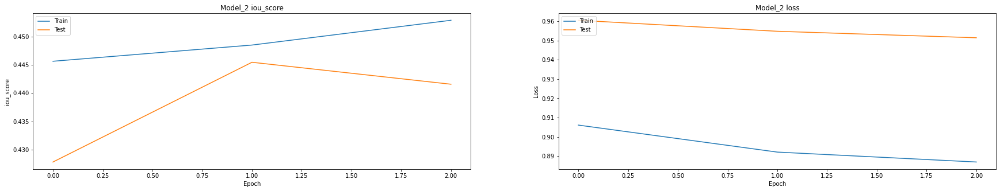

In [54]:
# Plot training & validation iou_score values
plt.figure(figsize=(30, 5))
plt.subplot(121)
plt.plot(history.history['iou_score'])
plt.plot(history.history['val_iou_score'])
plt.title('Model_2 iou_score')
plt.ylabel('iou_score')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')


# Plot training & validation loss values
plt.subplot(122)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model_2 loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()

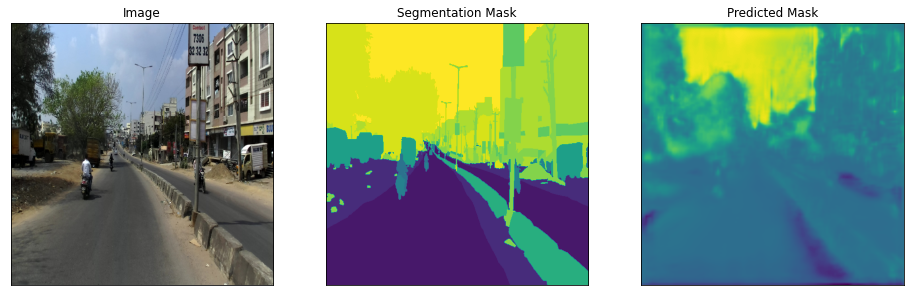

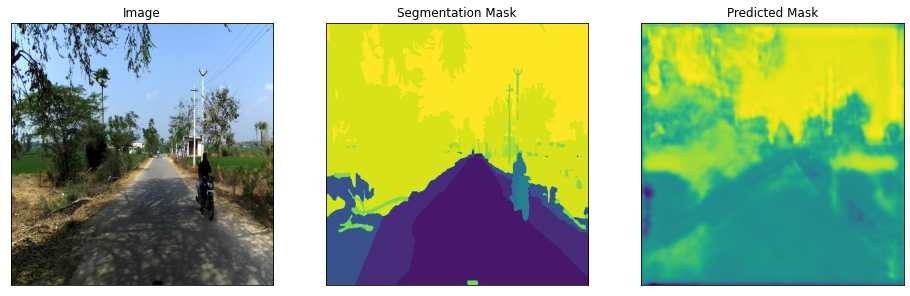

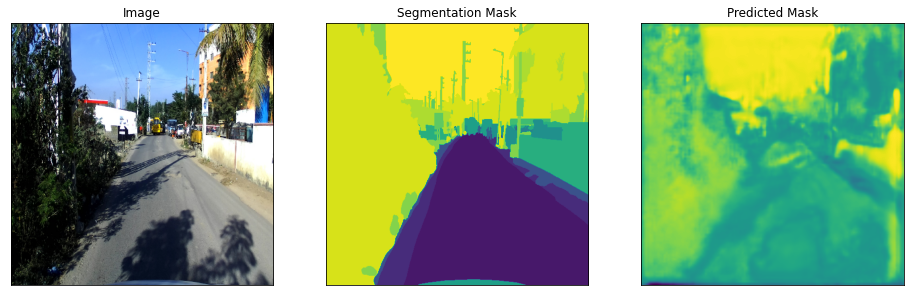

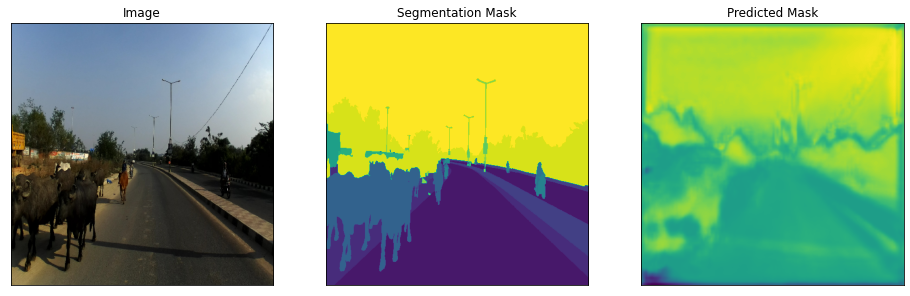

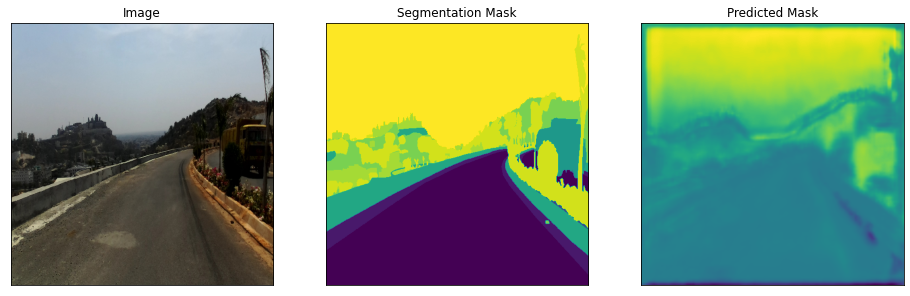

...

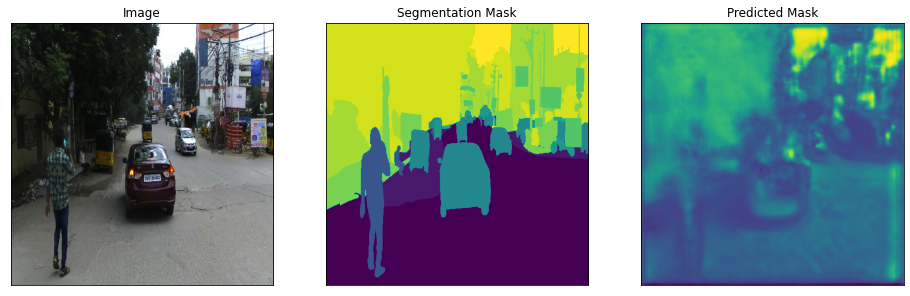

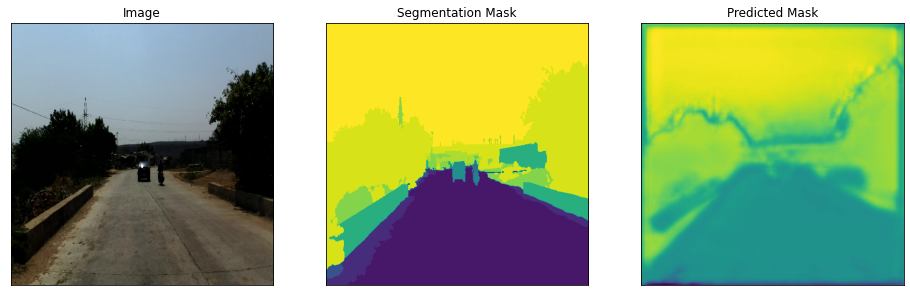

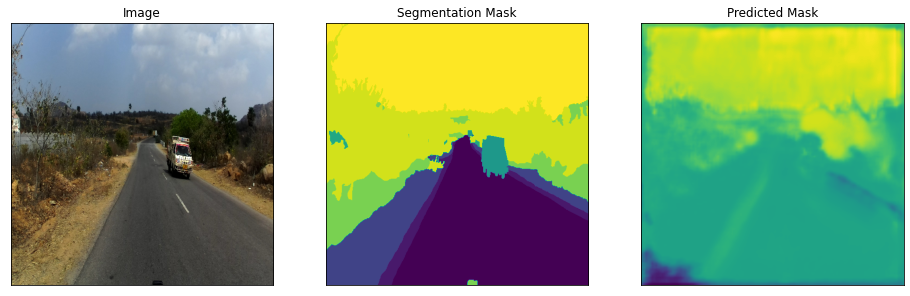

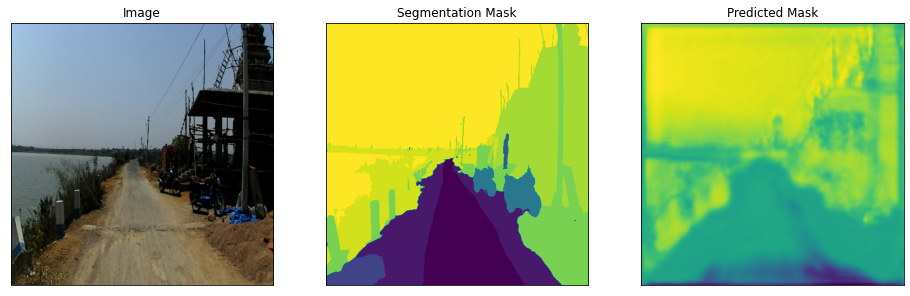

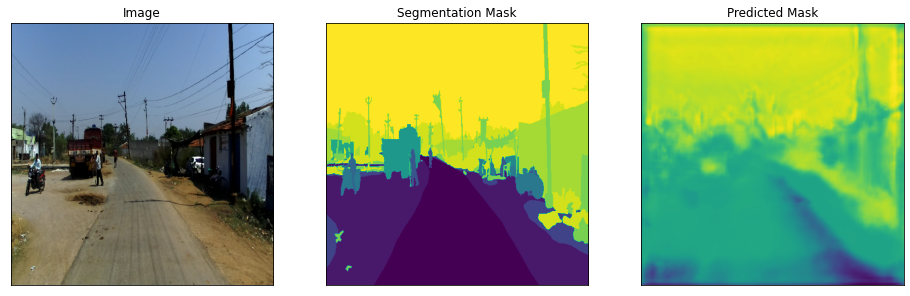

In [55]:
#visualizing 20 test images, their actual segmentation maps, predicted segmentation maps
for i in range(20):
    #print(test_dataloader[i][0].shape)
    segmentation_map = test_dataloader[i][1][0]
    segmentation_mask = np.sum(np.stack([segmentation_map[:,:,j]*j*10 for j in range(len(CLASSES))],axis=-1),axis=-1)
    predicted_mask = model_2.predict(test_dataloader[i][0])[0]
    predicted_mask = np.sum(np.stack([predicted_mask[:,:,j]*j*10 for j in range(len(CLASSES))],axis=-1),axis=-1)
    visualize(
    image=test_dataset[i][0], 
    segmentation_mask=segmentation_mask,
    predicted_mask=predicted_mask
    )

In [57]:
%tensorboard --logdir model_2_logs/fit

<IPython.core.display.Javascript object>

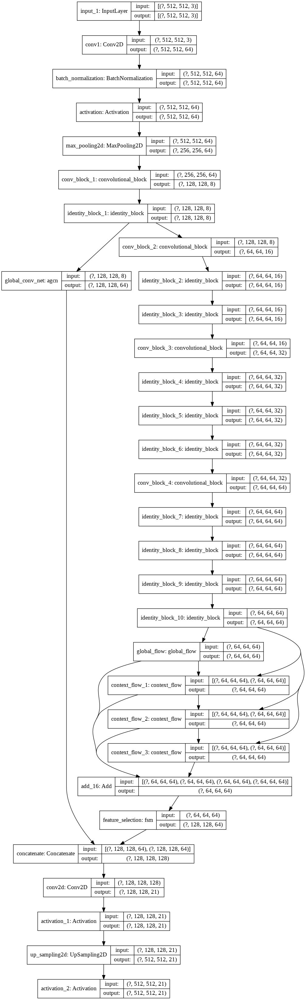

In [56]:
tf.keras.utils.plot_model(
    model_2, to_file='model_2.png', show_shapes=True, show_layer_names=True,
    rankdir='TB')

* as a part of this assignment we will be implementing the architecture based on this paper https://arxiv.org/pdf/2002.12041.pdf
* We will be using the custom layers concept that we used in seq-seq assignment
* You can devide the whole architecture can be devided into two parts
    1. Encoder
    2. Decoder
    <img src='https://i.imgur.com/prH3Mno.png' width="600">
* Encoder:
    * The first step of the encoder is to create the channel maps [$C_1$, $C_2$, $C_3$, $C_4$]
    * $C_1$ width and heigths are 4x times less than the original image
    * $C_2$ width and heigths are 8x times less than the original image
    * $C_3$ width and heigths are 8x times less than the original image
    * $C_4$ width and heigths are 8x times less than the original image
    * <i>you can reduce the dimensions by using stride parameter</i>.
    * [$C_1$, $C_2$, $C_3$, $C_4$] are formed by applying a "conv block" followed by $k$ number of "identity block". i.e the $C_k$ feature map will single "conv block" followed by $k$ number of "identity blocks".
    <table>
    <tr><td><img src="https://i.imgur.com/R8Gdypo.png" width="300"></td>
        <td><img src="https://i.imgur.com/KNunjQK.png" width="250"></td></tr>
    </table>
    * <strong>The conv block and identity block of $C_1$</strong>: the number filters in the covolutional layers will be $[4,4,8]$ and the number of filters in the parallel conv layer will also be $8$.
    * <strong>The conv block and identity block of $C_2$</strong>: the number filters in the covolutional layers will be $[8,8,16]$ and the number of filters in the parallel conv layer will also be $16$.
    * <strong>The conv block and identity block of $C_3$</strong>: the number filters in the covolutional layers will be $[16,16,32]$ and the number of filters in the parallel conv layer will also be $32$.
    * <strong>The conv block and identity block of $C_4$</strong>: the number filters in the covolutional layers will be $[32,32,64]$ and the number of filters in the parallel conv layer will also be $64$.
    * Here $\oplus$ represents the elementwise sum
    <br>
    
    <font color="red">NOTE: these filters are of your choice, you can explore more options also</font>
    
    * Example: if your image is of size $(512, 512, 3)$
        * the output after $C_1$ will be $128*128*8$
        * the output after $C_2$ will be $64*64*16$
        * the output after $C_3$ will be $64*64*32$
        * the output after $C_4$ will be $64*64*64$

* The output of the $C_4$ will be passed to $\text{Chained Context Aggregation Module (CAM)}$
<img src='https://i.imgur.com/Bu63AAA.png' width="400">
* The CAM module will have two operations names Context flow and Global flow
* <strong>The Global flow</strong>: 
    * as shown in the above figure first we willl apply  <a href="https://www.tensorflow.org/api_docs/python/tf/keras/layers/GlobalAveragePooling2D">global avg pooling</a> which results in (#, 1, 1, number_of_filters) then applying <a href="https://www.tensorflow.org/api_docs/python/tf/keras/layers/BatchNormalization?version=nightly">BN</a>, <a href="https://www.tensorflow.org/api_docs/python/tf/keras/layers/ReLU">RELU</a>, $1*1 \text{ Conv}$ layer sequentially which results a matrix (#, 1, 1, number_of_filters). Finally apply <a href="https://www.tensorflow.org/api_docs/python/tf/keras/layers/UpSampling2D">upsampling</a> / <a href="https://www.tensorflow.org/api_docs/python/tf/keras/layers/Conv2DTranspose">conv2d transpose</a> to make the output same as the input dimensions (#, input_height, input_width, number_of_filters)
    * If you use <a href="https://www.tensorflow.org/api_docs/python/tf/keras/layers/UpSampling2D">upsampling</a> then use bilinear pooling as interpolation technique
* <strong>The Context flow</strong>: 
    * as shown in the above figure (c) the context flow will get inputs from two modules `a. C4` `b. From the above flow` 
    * We will be <a href="https://www.tensorflow.org/api_docs/python/tf/keras/layers/Concatenate">concatinating</a> the both inputs on the last axis.
    * After the concatination we will be applying <a href="https://www.tensorflow.org/api_docs/python/tf/keras/layers/AveragePooling2D"> Average pooling </a> which reduces the size of feature map by $N\times$ times
    * In the paper it was mentioned that to apply a group convolutions, but for the assignment we will be applying the simple conv layers with kernel size $(3*3)$
    * We are skipping the channel shuffling 
    * similarly we will be applying a simple conv layers with kernel size $(3*3)$ consider this output is X
    * later we will get the Y=(X $\otimes \sigma((1\times1)conv(relu((1\times1)conv(X))))) \oplus X$, here $\oplus$ is elementwise addition and $\otimes$ is elementwise multiplication
    * Finally apply <a href="https://www.tensorflow.org/api_docs/python/tf/keras/layers/UpSampling2D">upsampling</a> / <a href="https://www.tensorflow.org/api_docs/python/tf/keras/layers/Conv2DTranspose">conv2d transpose</a> to make the output same as the input dimensions (#, input_height, input_width, number_of_filters)
    * If you use <a href="https://www.tensorflow.org/api_docs/python/tf/keras/layers/UpSampling2D">upsampling</a> then use bilinear pooling as interpolation technique

NOTE: here N times reduction and N time increments makes the input and out shape same, you can explore with the N values, you can choose N = 2 or 4

* Example with N=2:
    * Assume the C4 is of shape (64,64,64) then the shape of GF will be (64,64,32)
    * Assume the C4 is of shape (64,64,64) and the shape of GF is (64,64,32) then the shape of CF1 will be (64,64,32)
    * Assume the C4 is of shape (64,64,64) and the shape of CF1 is (64,64,32) then the shape of CF2 will be (64,64,32)
    * Assume the C4 is of shape (64,64,64) and the shape of CF2 is (64,64,32) then the shape of CF3 will be (64,64,32)

* As shown in the above architecture we will be having 4 context flows
* if you have implemented correctly all the shapes of Global Flow, and 3 context flows will have the same dimension
* the output of these 4 modules will be <a href="https://www.tensorflow.org/api_docs/python/tf/keras/layers/Add">added</a> to get the same output matrix
<img src='https://i.imgur.com/Bu63AAA.png' width="400">
 * The output of after the sum, will be sent to the <strong>Feature selection module $FSM$</strong>
 
* Example:
    * if the shapes of GF, CF1, CF2, CF3 are (64,64,32), (64,64,32), (64,64,32), (64,64,32), (64,64,32) respectivly then after the sum we will be getting (64,64,32), which will be passed to the next module.
 
<strong>Feature selection module</strong>:

* As part of the FSM we will be applying a conv layer (3,3) with the padding="same" so that the output and input will have same shapes
* Let call the output as X
* Pass the X to global pooling which results the matrix (#, 1, 1, number_of_channels)
* Apply $1*1$ conv layer, after the pooling
* the output of the $1*1$ conv layer will be passed to the Batch normalization layer, followed by Sigmoid activation function.
* we will be having the output matrix of shape (#, 1, 1, number_of_channels) lets call it 'Y'
* <strong>we can interpret this as attention mechanisum, i.e for each channel we will having a weight</strong>
* the dimension of X (#, w, h, k) and output above steps Y is (#, 1, 1, k) i.e we need to multiply each channel of X will be <a href="https://www.tensorflow.org/api_docs/python/tf/keras/layers/Multiply">multiplied</a> with corresponding channel of Y
* After creating the weighted channel map we will be doing upsampling such that it will double the height and width.
* apply <a href="https://www.tensorflow.org/api_docs/python/tf/keras/layers/UpSampling2D">upsampling</a> with bilinear pooling as interpolation technique

* <font color="red">Example</font>:
    * Assume the matrix shape of the input is (64,64,32) then after upsampling it will be (128,128,32)

* <b>Adapted Global Convolutional Network (AGCN)</b>:
    <img src="https://i.imgur.com/QNB8RmV.png" width="300">
    
    * AGCN will get the input from the output of the "conv block" of $C_1$
    
    * In all the above layers we will be using the padding="same" and stride=(1,1)
    
    * so that we can have the input and output matrices of same size
    
* <font color="red">Example</font>:
    * Assume the matrix shape of the input is (128,128,32) then the output it will be (128,128,32)

*     <img src='https://i.imgur.com/prH3Mno.png' width="600">
* as shown in the architecture, after we get the AGCN it will get concatinated with the FSM output

* If we observe the shapes both AGCN and FSM will have same height and weight

* we will be concatinating both these outputs over the last axis

* The concatinated output will be passed to a conv layers with filters = number of classes in our data set and the activation function = 'relu'

* we will be using padding="same" which results in the same size feature map

* If you observe the shape of matrix, it will be 4x times less than the original image

* to make it equal to the original output shape, we will do 4x times upsampling of rows and columns

* apply <a href="https://www.tensorflow.org/api_docs/python/tf/keras/layers/UpSampling2D">upsampling</a> with bilinear pooling as interpolation technique

* Finally we will be applying sigmoid activation.

* Example:
    * Assume the matrix shape of AGCN is (128,128,32)  and FSM is (128,128,32) the concatination will make it (128, 128, 64)
    * Applying conv layer will make it (128,128,21)
    * Finally applying upsampling will make it (512, 512, 21)
    * Applying sigmoid will result in the same matrix (512, 512, 21)